In [1]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None) # show all columns
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import helperFunctions
import collections

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, RobustScaler, label_binarize
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import GridSearchCV

from tqdm import tqdm, tqdm_notebook
tqdm.pandas()

/miniconda/lib/python3.7/site-packages/tqdm/std.py:703: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [2]:
# read the train and test csv files
og_train_df = pd.read_csv('feature_engineered_data/train.csv')
og_test_df = pd.read_csv('feature_engineered_data/test-3.csv')

In [3]:
print(f"Number of null values in og_train_df = {og_train_df.isnull().sum().sum()}")
print(f"Number of null values in og_test_df = {og_test_df.isnull().sum().sum()}")

Number of null values in og_train_df = 0
Number of null values in og_test_df = 0


In [4]:
og_train_df # showing all columns

,Date,league,HomeTeam,AwayTeam,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365pred,B365HDstDrw,B365ADstDrw,FTR
0,2009-08-07,bundesliga,Wolfsburg,Stuttgart,12,7,0,0,0,0,0,0,12,4,0,0,0,0,0,0,0,H,1.794872,0.933333,H
1,2009-08-08,bundesliga,Dortmund,FC Koln,8,11,0,0,0,0,0,0,10,0,1,0,0,0,0,0,0,H,2.314815,0.681818,H
2,2009-08-08,bundesliga,Hertha,Hannover,16,4,3,0,0,0,0,0,20,3,2,0,0,0,0,0,0,H,1.944444,0.777778,H
3,2009-08-08,bundesliga,Hoffenheim,Bayern Munich,10,1,0,0,0,0,0,1,28,3,2,0,0,0,0,1,0,A,0.809524,1.780105,D
4,2009-08-08,bundesliga,Mainz,Leverkusen,22,4,1,0,0,0,0,1,28,7,2,0,0,0,0,2,0,A,0.894737,1.700000,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12777,2017-05-28,serie-a,Inter,Udinese,15,6,2,0,1,0,4,3,1,4,1,0,1,2,2,0,0,H,4.135338,0.647059,H
12778,2017-05-28,serie-a,Palermo,Empoli,18,5,3,0,2,1,2,0,16,4,4,0,2,0,3,0,-1,A,0.721667,2.830065,H
12779,2017-05-28,serie-a,Roma,Genoa,8,7,2,0,4,0,1,1,14,4,0,0,2,0,3,1,1,H,14.150943,0.441176,H
12780,2017-05-28,serie-a,Sampdoria,Napoli,9,2,1,0,0,3,2,0,8,7,0,0,4,1,0,2,-1,A,0.500000,6.355932,A


In [5]:
og_test_df # showing all columns

,Date,league,HomeTeam,AwayTeam,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365pred,B365HDstDrw,B365ADstDrw
0,2017-08-18,bundesliga,Bayern Munich,Leverkusen,13,8,1,0,0,0,0,2,17,4,2,0,0,0,0,0,0,H,4.800000,0.500000
1,2017-08-19,bundesliga,Hamburg,Augsburg,18,5,4,0,0,0,0,1,16,1,3,0,0,0,0,0,0,H,1.619048,0.944444
2,2017-08-19,bundesliga,Hertha,Stuttgart,18,3,2,0,0,0,0,0,12,2,1,0,0,0,0,0,0,H,1.700000,0.871795
3,2017-08-19,bundesliga,Hoffenheim,Werder Bremen,17,3,1,0,0,0,0,0,15,2,3,0,0,0,0,0,0,H,2.285714,0.923788
4,2017-08-19,bundesliga,Mainz,Hannover,18,6,3,0,0,0,0,0,14,2,5,0,0,0,0,0,0,H,1.700000,0.850000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821,2018-05-20,serie-a,Milan,Fiorentina,10,11,2,0,2,2,1,2,5,3,1,1,2,0,3,1,0,H,2.076503,0.904762
1822,2018-05-20,serie-a,Napoli,Crotone,3,9,0,0,3,1,1,2,9,4,0,0,2,2,1,0,0,H,3.166667,0.826087
1823,2018-05-20,serie-a,Sassuolo,Roma,14,3,1,0,4,0,1,0,8,6,1,0,4,1,0,1,1,A,0.950000,2.054054
1824,2018-05-20,serie-a,Spal,Sampdoria,10,6,1,0,2,1,2,1,11,3,4,0,2,0,3,0,0,H,2.484472,0.727273


In [6]:
og_train_df.columns

Index(['Date', 'league', 'HomeTeam', 'AwayTeam', 'HF', 'HST', 'HY', 'HR',
       'HPr5MW', 'HPr5MD', 'HPr5ML', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'APr5MW',
       'APr5MD', 'APr5ML', 'HTAG', 'RstDayDiff', 'B365pred', 'B365HDstDrw',
       'B365ADstDrw', 'FTR'],
      dtype='object')

In [7]:
og_test_df.columns

Index(['Date', 'league', 'HomeTeam', 'AwayTeam', 'HF', 'HST', 'HY', 'HR',
       'HPr5MW', 'HPr5MD', 'HPr5ML', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'APr5MW',
       'APr5MD', 'APr5ML', 'HTAG', 'RstDayDiff', 'B365pred', 'B365HDstDrw',
       'B365ADstDrw'],
      dtype='object')

A reminder about what each columns means  

- HF, AF = Fouls committed by HomeTeam and AwayTeam respectively  
- HY, AY = Yellow cards given by the referee to HomeTeam and AwayTeam respectively  
- HR, AR = Red cards given by the referee to HomeTeam and AwayTeam respectively  
- HST, AST = Shots on Target attempted by HomeTeam and AwayTeam respectively  
- HPr5MW, APr5MW = Number of wins in the last 5 matches for the HomeTeam and AwayTeam respectively  
- HPr5MD, APr5MD = Number of draws in the last 5 matches for the HomeTeam and AwayTeam respectively  
- HPr5ML, APr5ML = Number of losses in the last 5 matches for the HomeTeam and AwayTeam respectively  
- HTHG, HTAG = Number of goals by HomeTeam and AwayTeam at Half-time
- RstDayDiff = difference in the number of days of rest the two teams had. Positive values mean that the HomeTeam had one or more days of rest than the AwayTeam. Negative values mean AwayTeam had more days of rest. Zero means both teams had same days of rest. This feature captures the team fatigue.
- B365pred = captures what the betting crowd thinks who the winner will be.   
- B365HDstDrw, B365ADstDrw = distance from draw for HomeTeam/AwayTeam based on Bet365 betting odds.

In [8]:
og_train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12782 entries, 0 to 12781
Data columns (total 25 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Date         12782 non-null  object 
 1   league       12782 non-null  object 
 2   HomeTeam     12782 non-null  object 
 3   AwayTeam     12782 non-null  object 
 4   HF           12782 non-null  int64  
 5   HST          12782 non-null  int64  
 6   HY           12782 non-null  int64  
 7   HR           12782 non-null  int64  
 8   HPr5MW       12782 non-null  int64  
 9   HPr5MD       12782 non-null  int64  
 10  HPr5ML       12782 non-null  int64  
 11  HTHG         12782 non-null  int64  
 12  AF           12782 non-null  int64  
 13  AST          12782 non-null  int64  
 14  AY           12782 non-null  int64  
 15  AR           12782 non-null  int64  
 16  APr5MW       12782 non-null  int64  
 17  APr5MD       12782 non-null  int64  
 18  APr5ML       12782 non-null  int64  
 19  HTAG

In [9]:
og_test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1826 entries, 0 to 1825
Data columns (total 24 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Date         1826 non-null   object 
 1   league       1826 non-null   object 
 2   HomeTeam     1826 non-null   object 
 3   AwayTeam     1826 non-null   object 
 4   HF           1826 non-null   int64  
 5   HST          1826 non-null   int64  
 6   HY           1826 non-null   int64  
 7   HR           1826 non-null   int64  
 8   HPr5MW       1826 non-null   int64  
 9   HPr5MD       1826 non-null   int64  
 10  HPr5ML       1826 non-null   int64  
 11  HTHG         1826 non-null   int64  
 12  AF           1826 non-null   int64  
 13  AST          1826 non-null   int64  
 14  AY           1826 non-null   int64  
 15  AR           1826 non-null   int64  
 16  APr5MW       1826 non-null   int64  
 17  APr5MD       1826 non-null   int64  
 18  APr5ML       1826 non-null   int64  
 19  HTAG  

We are going to drop all the columns in `train_df` and `test_df` that are not needed for the linear model. They are  

- Date, league, HomeTeam, AwayTeam :: all of these have been captured and none of these can be an input to a linear model.
- B365Pred :: since the columns B365HDstDrw, B365ADstDrw already quantitively capture this for the linear model.

In [10]:
og_train_df = og_train_df.drop(columns=['Date', 'league', 'HomeTeam', 'AwayTeam', 'B365pred'])
og_test_df = og_test_df.drop(columns=['Date', 'league', 'HomeTeam', 'AwayTeam', 'B365pred'])

In [11]:
og_train_df.columns

Index(['HF', 'HST', 'HY', 'HR', 'HPr5MW', 'HPr5MD', 'HPr5ML', 'HTHG', 'AF',
       'AST', 'AY', 'AR', 'APr5MW', 'APr5MD', 'APr5ML', 'HTAG', 'RstDayDiff',
       'B365HDstDrw', 'B365ADstDrw', 'FTR'],
      dtype='object')

In [12]:
og_test_df.columns

Index(['HF', 'HST', 'HY', 'HR', 'HPr5MW', 'HPr5MD', 'HPr5ML', 'HTHG', 'AF',
       'AST', 'AY', 'AR', 'APr5MW', 'APr5MD', 'APr5ML', 'HTAG', 'RstDayDiff',
       'B365HDstDrw', 'B365ADstDrw'],
      dtype='object')

In [13]:
print(f"len(train_df.columns) = {len(og_train_df.columns)}")
print(f"len(test_df.columns) = {len(og_test_df.columns)}")

len(train_df.columns) = 20
len(test_df.columns) = 19


The target column i.e. the FTR column is difference between the two dataframes.

In [14]:
print("Unique datatypes in og_train_df columns =", list(np.unique(og_train_df.dtypes)))
print("Unique datatypes in og_test_df columns =", list(np.unique(og_test_df.dtypes)))

Unique datatypes in og_train_df columns = [dtype('int64'), dtype('float64'), dtype('O')]
Unique datatypes in og_test_df columns = [dtype('int64'), dtype('float64')]


The object datatype in the train_df comes from the FTR column. Other than this column, all other columns are suitable as input for a linear model.  



One of the linear algorithms I have in mind to apply is the **Multinomial Logistic Regression**. This would be a good choice of algorithm to try because with so many numeric columns, we can assign importances to the features (with the help of parameters) and try to fit the target column. 

The changes which we will make below are all to aid the performance of a Logistic Regression model. Since, the Logistic Regression library we will use makes use of optimization algorithm, it is best that we scale our features so that they reach convergence ASAP.

Next, we need to scale (usually between 0 and 1) or standardize (mean=0, sd=1) our features before training our linear model so that when we apply the regularization, the regularization impact is not lopsided due to one big variable that contains larger values. For e.g. HF and AF are such variables. Scaling and Standardization is also important when the algorithm makes use of Gradient Descent. It gets closer to convergence than without these techniques.

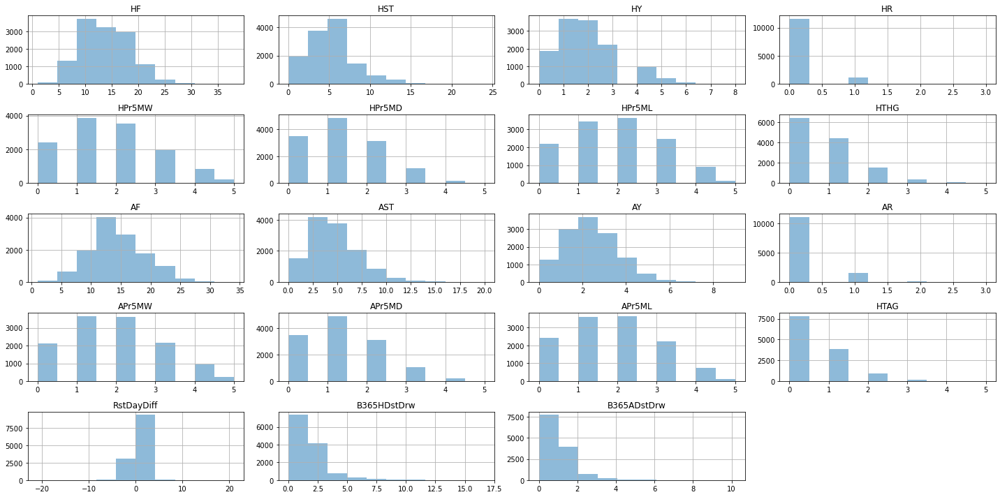

In [15]:
og_train_df.hist(figsize=(20, 10), alpha=0.5)
plt.tight_layout()

Let us look at the same data in a box and whisker plot. This will tell us where most of the data lies and where the outliers are.

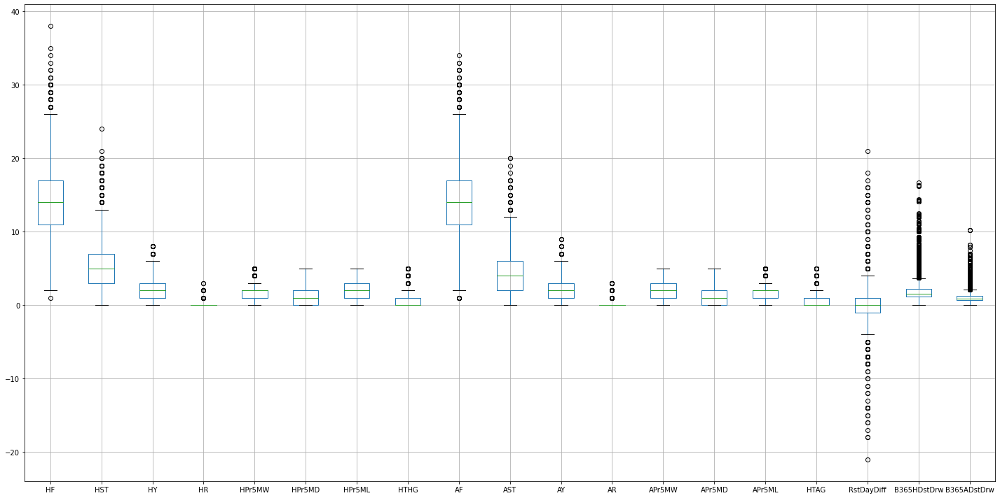

In [16]:
og_train_df.boxplot(figsize=(20, 10))
plt.tight_layout()

In [17]:
og_train_df.describe()

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw
count,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000,12782.000000
mean,13.917540,5.268346,1.862541,0.101236,1.653575,1.195118,1.748631,0.690972,14.412064,4.177593,2.173525,0.140041,1.754499,1.186199,1.656939,0.494758,0.001565,1.952050,1.124995
std,4.571961,2.872722,1.313102,0.320516,1.217522,0.986941,1.209375,0.833129,4.668116,2.497301,1.367612,0.377703,1.236890,0.981196,1.187021,0.713860,1.553419,1.495639,0.773742
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-21.000000,0.000000,0.000000
25%,11.000000,3.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,11.000000,2.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,-1.000000,1.145833,0.688889
50%,14.000000,5.000000,2.000000,0.000000,2.000000,1.000000,2.000000,0.000000,14.000000,4.000000,2.000000,0.000000,2.000000,1.000000,2.000000,0.000000,0.000000,1.547619,0.928571
75%,17.000000,7.000000,3.000000,0.000000,2.000000,2.000000,3.000000,1.000000,17.000000,6.000000,3.000000,0.000000,3.000000,2.000000,2.000000,1.000000,1.000000,2.181818,1.250000
max,38.000000,24.000000,8.000000,3.000000,5.000000,5.000000,5.000000,5.000000,34.000000,20.000000,9.000000,3.000000,5.000000,5.000000,5.000000,5.000000,21.000000,16.666667,10.185185


In [18]:
og_train_df.describe().iloc[[1, 5], :] # easy way to check of distribution of each feature

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw
mean,13.91754,5.268346,1.862541,0.101236,1.653575,1.195118,1.748631,0.690972,14.412064,4.177593,2.173525,0.140041,1.754499,1.186199,1.656939,0.494758,0.001565,1.952050,1.124995
50%,14.00000,5.000000,2.000000,0.000000,2.000000,1.000000,2.000000,0.000000,14.000000,4.000000,2.000000,0.000000,2.000000,1.000000,2.000000,0.000000,0.000000,1.547619,0.928571


Since almost most median values are close to mean values, it looks like all of them are normally distributed. But the Box and Whisker plots tell us the opposite i.e. the data is greatly skewed. Let's cross-check this is QQ plots. 

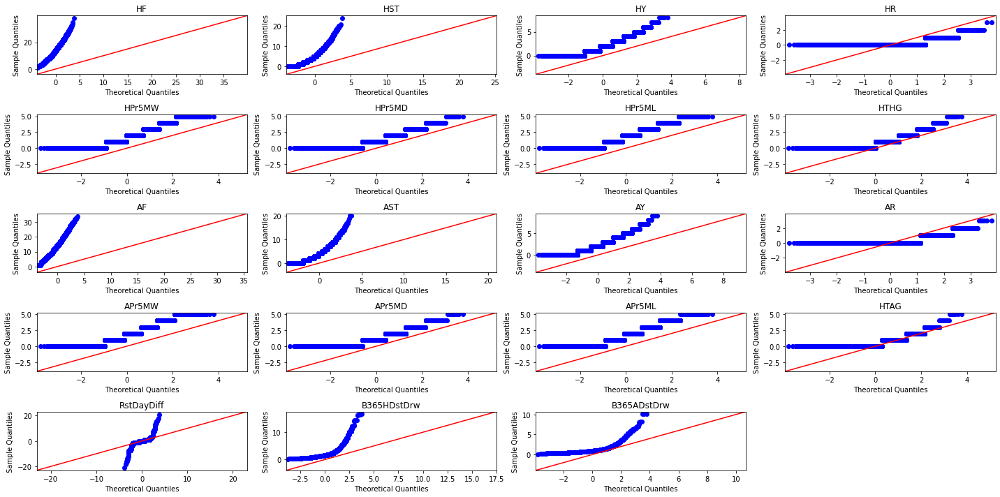

In [19]:
fig, axs = plt.subplots(figsize=(20, 10))
for ix, column in enumerate(og_train_df.columns[:-1]):
    plt.subplot(5, 4, ix+1)
    plt.title(column)
    sm.qqplot(og_train_df[column], ax= plt.gca(), line="45")
plt.tight_layout()

We can see that none of them are Normally distributed. Also, a good number of them have a lot of outliers which can mess up our mean if we try to stadardize them. We either apply `sklearn.preprocessing.RobustScaler` (where there are many outliers) or `sklearn.preprocessing.MinMaxScaler` where needed.

In [20]:
mms, rs = MinMaxScaler(), RobustScaler()

mms_transformer = mms.fit(og_train_df[['HPr5MW', 'HPr5MD', 'HPr5ML', 'APr5MW', 'APr5MD', 'APr5ML']]) # since these columns range between 0 and 5
rs_transformer = rs.fit(og_train_df[['HF', 'HST', 'HY', 'HR', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'HTAG', 'RstDayDiff', 'B365HDstDrw', 'B365ADstDrw']]) # since these are skewed and have a lot of outliers

In [21]:
mms_transformer.get_params()

{'copy': True, 'feature_range': (0, 1)}

In [22]:
rs_transformer.get_params()

{'copy': True,
 'quantile_range': (25.0, 75.0),
 'with_centering': True,
 'with_scaling': True}

In [23]:
og_train_df[['HPr5MW', 'HPr5MD', 'HPr5ML', 'APr5MW', 'APr5MD', 'APr5ML']] = mms_transformer.transform(og_train_df[['HPr5MW', 'HPr5MD', 'HPr5ML', 'APr5MW', 'APr5MD', 'APr5ML']])

In [24]:
og_train_df # we see that it has produced the intended effects

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw,FTR
0,12,7,0,0,0.0,0.0,0.0,0,12,4,0,0,0.0,0.0,0.0,0,0,1.794872,0.933333,H
1,8,11,0,0,0.0,0.0,0.0,0,10,0,1,0,0.0,0.0,0.0,0,0,2.314815,0.681818,H
2,16,4,3,0,0.0,0.0,0.0,0,20,3,2,0,0.0,0.0,0.0,0,0,1.944444,0.777778,H
3,10,1,0,0,0.0,0.0,0.0,1,28,3,2,0,0.0,0.0,0.0,1,0,0.809524,1.780105,D
4,22,4,1,0,0.0,0.0,0.0,1,28,7,2,0,0.0,0.0,0.0,2,0,0.894737,1.700000,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12777,15,6,2,0,0.2,0.0,0.8,3,1,4,1,0,0.2,0.4,0.4,0,0,4.135338,0.647059,H
12778,18,5,3,0,0.4,0.2,0.4,0,16,4,4,0,0.4,0.0,0.6,0,-1,0.721667,2.830065,H
12779,8,7,2,0,0.8,0.0,0.2,1,14,4,0,0,0.4,0.0,0.6,1,1,14.150943,0.441176,H
12780,9,2,1,0,0.0,0.6,0.4,0,8,7,0,0,0.8,0.2,0.0,2,-1,0.500000,6.355932,A


In [25]:
# next, we do the same test_df except we use the fitted transformer we built using the train_df since we should not draw any stats from the test_df but merely apply our learning from train_df onto test_df

og_test_df[['HPr5MW', 'HPr5MD', 'HPr5ML', 'APr5MW', 'APr5MD', 'APr5ML']] = mms_transformer.transform(og_test_df[['HPr5MW', 'HPr5MD', 'HPr5ML', 'APr5MW', 'APr5MD', 'APr5ML']])

In [26]:
og_test_df # again, behaving as intended

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw
0,13,8,1,0,0.0,0.0,0.0,2,17,4,2,0,0.0,0.0,0.0,0,0,4.800000,0.500000
1,18,5,4,0,0.0,0.0,0.0,1,16,1,3,0,0.0,0.0,0.0,0,0,1.619048,0.944444
2,18,3,2,0,0.0,0.0,0.0,0,12,2,1,0,0.0,0.0,0.0,0,0,1.700000,0.871795
3,17,3,1,0,0.0,0.0,0.0,0,15,2,3,0,0.0,0.0,0.0,0,0,2.285714,0.923788
4,18,6,3,0,0.0,0.0,0.0,0,14,2,5,0,0.0,0.0,0.0,0,0,1.700000,0.850000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821,10,11,2,0,0.4,0.4,0.2,2,5,3,1,1,0.4,0.0,0.6,1,0,2.076503,0.904762
1822,3,9,0,0,0.6,0.2,0.2,2,9,4,0,0,0.4,0.4,0.2,0,0,3.166667,0.826087
1823,14,3,1,0,0.8,0.0,0.2,0,8,6,1,0,0.8,0.2,0.0,1,1,0.950000,2.054054
1824,10,6,1,0,0.4,0.2,0.4,1,11,3,4,0,0.4,0.0,0.6,0,0,2.484472,0.727273


Next, we apply the `rs_transform` on `train_df` and `test_df`

In [27]:
og_train_df[['HF', 'HST', 'HY', 'HR', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'HTAG', 'RstDayDiff', 'B365HDstDrw', 'B365ADstDrw']] = \
    rs_transformer.transform(og_train_df[['HF', 'HST', 'HY', 'HR', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'HTAG', 'RstDayDiff', 'B365HDstDrw', 'B365ADstDrw']])

og_test_df[['HF', 'HST', 'HY', 'HR', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'HTAG', 'RstDayDiff', 'B365HDstDrw', 'B365ADstDrw']] = \
    rs_transformer.transform(og_test_df[['HF', 'HST', 'HY', 'HR', 'HTHG', 'AF', 'AST', 'AY', 'AR', 'HTAG', 'RstDayDiff', 'B365HDstDrw', 'B365ADstDrw']])

Viewing these dataframes again...

In [28]:
og_train_df

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw,FTR
0,-0.333333,0.50,-1.0,0.0,0.0,0.0,0.0,0.0,-0.333333,0.00,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.238664,0.008487,H
1,-1.000000,1.50,-1.0,0.0,0.0,0.0,0.0,0.0,-0.666667,-1.00,-0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.740547,-0.439758,H
2,0.333333,-0.25,0.5,0.0,0.0,0.0,0.0,0.0,1.000000,-0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.383042,-0.268741,H
3,-0.666667,-1.00,-1.0,0.0,0.0,0.0,0.0,1.0,2.333333,-0.25,0.0,0.0,0.0,0.0,0.0,1.0,0.0,-0.712458,1.517584,D
4,1.333333,-0.25,-0.5,0.0,0.0,0.0,0.0,1.0,2.333333,0.75,0.0,0.0,0.0,0.0,0.0,2.0,0.0,-0.630204,1.374823,D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12777,0.166667,0.25,0.0,0.0,0.2,0.0,0.8,3.0,-2.166667,0.00,-0.5,0.0,0.2,0.4,0.4,0.0,0.0,2.497835,-0.501706,H
12778,0.666667,0.00,0.5,0.0,0.4,0.2,0.4,0.0,0.333333,0.00,1.0,0.0,0.4,0.0,0.6,0.0,-0.5,-0.797263,3.388801,H
12779,-1.000000,0.50,0.0,0.0,0.8,0.0,0.2,1.0,0.000000,0.00,-1.0,0.0,0.4,0.0,0.6,1.0,0.5,12.165549,-0.868625,H
12780,-0.833333,-0.75,-0.5,0.0,0.0,0.6,0.4,0.0,-1.000000,0.75,-1.0,0.0,0.8,0.2,0.0,2.0,-0.5,-1.011230,9.672524,A


In [29]:
og_test_df

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw
0,-0.166667,0.75,-0.5,0.0,0.0,0.0,0.0,2.0,0.500000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.139410,-0.763791
1,0.666667,0.00,1.0,0.0,0.0,0.0,0.0,1.0,0.333333,-0.75,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.068948,0.028289
2,0.666667,-0.50,0.0,0.0,0.0,0.0,0.0,0.0,-0.333333,-0.50,-0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.147088,-0.101186
3,0.500000,-0.50,-0.5,0.0,0.0,0.0,0.0,0.0,0.166667,-0.50,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.712458,-0.008526
4,0.666667,0.25,0.5,0.0,0.0,0.0,0.0,0.0,0.000000,-0.50,1.5,0.0,0.0,0.0,0.0,0.0,0.0,0.147088,-0.140028
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821,-0.666667,1.50,0.0,0.0,0.4,0.4,0.2,2.0,-1.500000,-0.25,-0.5,1.0,0.4,0.0,0.6,1.0,0.0,0.510513,-0.042433
1822,-1.833333,1.00,-1.0,0.0,0.6,0.2,0.2,2.0,-0.833333,0.00,-1.0,0.0,0.4,0.4,0.2,0.0,0.0,1.562810,-0.182646
1823,0.000000,-0.50,-0.5,0.0,0.8,0.0,0.2,0.0,-1.000000,0.50,-0.5,0.0,0.8,0.2,0.0,1.0,0.5,-0.576861,2.005811
1824,-0.666667,0.25,-0.5,0.0,0.4,0.2,0.4,1.0,-0.500000,-0.25,1.0,0.0,0.4,0.0,0.6,0.0,0.0,0.904311,-0.358750


Before we change anything with the FTR column, we need to split our train_df into training and validation data. One important thing to note is that **all the changes we have made in terms of data exploration and feature engineering has respected the time component of the data i.e. for no match have we looked ahead in time and added a column to train_df and test_df. Therefore, we can treat each row indenpendently while making the prediction. **  

Let us check the distribution of the FTR column in train_df

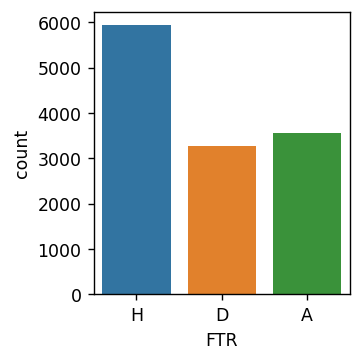

In [30]:
# dist. of the target variable in og_train_df
plt.figure(figsize=(3, 3), dpi=125)
plt.subplot(1, 1, 1)
sns.countplot(x='FTR', data = og_train_df)
plt.tight_layout()

In [32]:
np.round(np.array(list(collections.Counter(og_train_df["FTR"]).values()))/len(og_train_df["FTR"])*100, 3)  # percentage distribution of homeWins, draws, awayWins in the og_train_df

array([46.401, 25.685, 27.914])

In [35]:
# assuming 80-20 split for train and validation, we will get roughly these many rows in the two splits

print(f"Number of rows in training split = {int(np.ceil(len(og_train_df)*0.8))}")
print(f"Number of rows in validation split = {len(og_train_df) - int(np.ceil(len(og_train_df)*0.8))}")

Number of rows in training split = 10226
Number of rows in validation split = 2556


We need to have a validation set to evaluate the model we have developed. For that reason, we will split our `og_train_df` into train_df and valid_df. The split will be stratified by the FTR column.

In [36]:
train_df, vld_df = train_test_split(og_train_df, test_size=0.2, random_state=0, stratify=og_train_df["FTR"]) # we will be setting random_state=0 everytime we break og_train_df into train_df and vld_df

In [37]:
train_df

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw,FTR
1324,-0.500000,-0.75,-1.0,0.0,0.6,0.0,0.4,0.0,0.000000,0.50,0.5,0.0,0.4,0.0,0.6,1.0,-0.5,0.022983,0.025460,A
4609,0.000000,0.50,1.5,0.0,0.0,0.4,0.6,1.0,-1.000000,1.25,0.5,0.0,0.8,0.0,0.2,1.0,0.0,-0.797263,3.388801,A
857,-0.833333,0.25,-0.5,0.0,0.4,0.0,0.6,1.0,-0.666667,0.50,-1.0,0.0,0.6,0.2,0.2,2.0,-0.5,-0.166623,0.373116,A
12283,-0.833333,-0.50,0.0,0.0,0.6,0.4,0.0,1.0,-0.333333,0.00,-0.5,0.0,0.2,0.6,0.2,0.0,-0.5,0.458986,-0.407355,H
11088,0.333333,0.50,-1.0,0.0,0.4,0.2,0.4,0.0,1.833333,0.25,0.0,0.0,0.2,0.6,0.2,0.0,-2.5,-0.192853,0.019288,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2471,0.000000,0.75,-0.5,0.0,0.2,0.6,0.2,1.0,0.166667,0.00,0.5,0.0,0.4,0.2,0.4,0.0,0.0,0.651171,-0.585573,H
4306,-0.333333,-0.25,0.0,0.0,0.2,0.0,0.8,1.0,-0.500000,1.00,-0.5,0.0,0.6,0.2,0.2,2.0,-0.5,-0.838861,4.223833,A
2590,1.000000,0.50,2.0,0.0,0.2,0.4,0.4,1.0,-1.166667,0.00,0.0,0.0,0.4,0.4,0.2,0.0,0.5,-0.528598,1.230552,H
5586,0.833333,-0.75,0.0,1.0,0.0,0.0,0.4,1.0,0.166667,0.50,1.0,0.0,0.2,0.2,0.0,0.0,0.0,-0.425176,0.445787,H


In [38]:
vld_df

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw,FTR
7587,0.166667,-0.50,-0.5,0.0,0.4,0.4,0.2,0.0,-0.166667,0.75,0.0,0.0,0.4,0.2,0.4,0.0,-0.5,0.068948,0.076379,H
4927,0.500000,0.00,0.0,0.0,0.4,0.2,0.4,0.0,1.333333,-0.50,1.0,0.0,0.6,0.2,0.2,0.0,0.5,-0.440846,0.325318,H
2799,1.500000,0.00,0.0,0.0,0.4,0.2,0.4,0.0,0.000000,0.25,0.0,0.0,0.2,0.4,0.4,1.0,-0.5,0.147088,-0.039038,A
10086,-1.000000,0.00,1.0,0.0,0.2,0.6,0.2,0.0,-0.833333,0.25,0.0,0.0,1.0,0.0,0.0,0.0,0.5,-0.897669,5.028289,H
8985,-0.666667,0.25,-0.5,0.0,0.0,0.0,0.0,0.0,-0.666667,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.219713,0.242278,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7219,1.166667,0.25,0.5,0.0,0.4,0.4,0.2,1.0,-0.500000,0.25,0.5,1.0,0.2,0.6,0.2,0.0,0.5,-0.335545,0.015912,A
10953,0.500000,-0.25,0.0,0.0,0.6,0.2,0.2,1.0,0.000000,0.00,0.0,0.0,0.4,0.0,0.6,1.0,0.0,-0.513515,0.919378,D
8723,-1.333333,1.25,-0.5,0.0,0.8,0.0,0.2,0.0,-0.666667,0.50,-0.5,0.0,0.0,0.4,0.6,0.0,0.0,4.693734,-0.763791,H
3799,0.000000,1.00,0.0,0.0,0.4,0.2,0.4,0.0,-1.000000,-0.50,0.0,0.0,0.4,0.4,0.2,0.0,-1.0,0.673649,-0.439758,H


We check the distribution of train_df and vld_df to see if the FTR column has same distribution as the `og_train_df`.

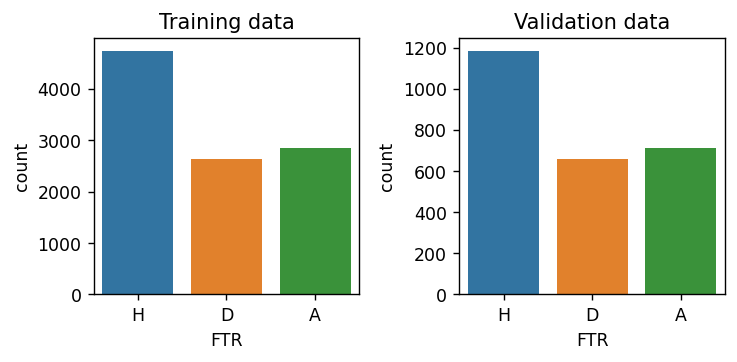

In [39]:
plt.figure(figsize=(6, 3), dpi=125)
plt.subplot(1, 2, 1)
sns.countplot(x='FTR', data = train_df, order=['H', 'D', 'A'])
plt.title("Training data")

plt.subplot(1, 2, 2)
sns.countplot(x='FTR', data = vld_df, order=['H', 'D', 'A'])
plt.title("Validation data")

plt.tight_layout()

Putting that in percentages of each class

In [41]:
np.round((np.array([tup[1] for tup in sorted(collections.Counter(train_df["FTR"]).items(), reverse=True)])/len(train_df))*100, 3) # H, D, A distribution percentages in train_df

array([46.406, 25.682, 27.912])

In [42]:
np.round((np.array([tup[1] for tup in sorted(collections.Counter(vld_df["FTR"]).items(), reverse=True)])/len(vld_df))*100, 3) # H, D, A distribution percentages in vld_df

array([46.382, 25.694, 27.923])

Next, we separate the target column from the rest of the dataframe. Also, we need to supply the target column in terms of integer to run the GridSearch CV with LogisticRegression.

In [46]:
# FTR is the last column which explains the -1 we see here
train_X = train_df.iloc[:, :-1]
vld_X = vld_df.iloc[:, :-1]

train_yTrue = train_df.iloc[:, -1].replace({'H': 1, 'D': 0, 'A': -1}).astype(np.int8)
vld_yTrue = vld_df.iloc[:, -1].replace({'H': 1, 'D': 0, 'A': -1}).astype(np.int8)

In [47]:
train_yTrue

1324    -1
4609    -1
857     -1
12283    1
11088   -1
        ..
2471     1
4306    -1
2590     1
5586     1
6860    -1
Name: FTR, Length: 10225, dtype: int8

In [48]:
vld_yTrue

7587     1
4927     1
2799    -1
10086    1
8985    -1
        ..
7219    -1
10953    0
8723     1
3799     1
6910    -1
Name: FTR, Length: 2557, dtype: int8

In [60]:
param_grid = [{
        'penalty': ['l1', 'elasticnet'],
        'C': [1e-2, 1e-1, 1.0], # smaller values of C specify stronger regularization
        'solver': ['saga'],
        'max_iter': [100, 200, 500, 750, 1000] 
    },
    {
        'penalty': ['none', 'l2'],
        'C': [1e-2, 1e-1, 1.0], # smaller values of C specify stronger regularization
        'solver': ['newton-cg', 'lbfgs', 'sag', 'saga'], 
        'max_iter': [100, 500, 1000]
    }]

We need to choose a scoring metric so that the GridSearch returns the best parameters for Logistic Regression for this metric.  

We are going to choose `precision_macro`. `precision` because we want to end up with a model that is confident of the predictions it makes. `macro` because we do not want the class imbalance to play a role i.e. we do not want the model to give more priority of prediciting HomeTeam win since that constitutes 46% of the training data.

**The idea that we want a model that is confident of the prediction it has made is our decision. If our priority/goal of building this model changes, then the metric to optimize on also changes.**

In [119]:
gridSearcher = GridSearchCV(LogisticRegression(multi_class='multinomial', class_weight='balanced'), param_grid=param_grid, scoring='precision_macro', verbose=1, n_jobs=-1, cv=5)
# stratified 5-fold CV is automatically handled

In [120]:
gridSearcher

GridSearchCV(cv=5,
             estimator=LogisticRegression(class_weight='balanced',
                                          multi_class='multinomial'),
             n_jobs=-1,
             param_grid=[{'C': [0.01, 0.1, 1.0],
                          'max_iter': [100, 200, 500, 750, 1000],
                          'penalty': ['l1', 'elasticnet'], 'solver': ['saga']},
                         {'C': [0.01, 0.1, 1.0], 'max_iter': [100, 500, 1000],
                          'penalty': ['none', 'l2'],
                          'solver': ['newton-cg', 'lbfgs', 'sag', 'saga']}],
             scoring='precision_macro', verbose=1)

In [121]:
gridSearcher.fit(X=train_X, y=train_yTrue)

Fitting 5 folds for each of 102 candidates, totalling 510 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done 106 tasks      | elapsed:    7.4s
[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 510 out of 510 | elapsed:  3.7min finished


GridSearchCV(cv=5,
             estimator=LogisticRegression(class_weight='balanced',
                                          multi_class='multinomial'),
             n_jobs=-1,
             param_grid=[{'C': [0.01, 0.1, 1.0],
                          'max_iter': [100, 200, 500, 750, 1000],
                          'penalty': ['l1', 'elasticnet'], 'solver': ['saga']},
                         {'C': [0.01, 0.1, 1.0], 'max_iter': [100, 500, 1000],
                          'penalty': ['none', 'l2'],
                          'solver': ['newton-cg', 'lbfgs', 'sag', 'saga']}],
             scoring='precision_macro', verbose=1)

In [122]:
gridSearcher.best_score_ # mean cross-validated precision_macro score

0.6361665480284379

In [123]:
gridSearcher.best_params_

{'C': 1.0, 'max_iter': 100, 'penalty': 'l1', 'solver': 'saga'}

In [124]:
gridSearcher.best_estimator_ # we will make use of this model to predict our vld_df

LogisticRegression(class_weight='balanced', multi_class='multinomial',
                   penalty='l1', solver='saga')

In [125]:
clf = gridSearcher.best_estimator_

In [126]:
vld_yPred = clf.predict(vld_X)

In [127]:
clf.classes_

array([-1,  0,  1], dtype=int8)

In [128]:
vld_confMat = confusion_matrix(y_true=vld_yTrue, y_pred=vld_yPred, labels=clf.classes_)

In [129]:
vld_confMat

array([[472, 187,  55],
       [175, 321, 161],
       [ 75, 311, 800]])

In [130]:
helperFunctions.normalizeConfusionMatrix(vld_confMat) # get normalized CM

array([[0.661, 0.262, 0.077],
       [0.266, 0.489, 0.245],
       [0.063, 0.262, 0.675]])

In [131]:
helperFunctions.calculate_accuracy(vld_confMat)

'Accuracy = 62.3%'

In [132]:
print(classification_report(y_true=vld_yTrue, y_pred=vld_yPred, labels=[-1., 0., 1]))

              precision    recall  f1-score   support

        -1.0       0.65      0.66      0.66       714
         0.0       0.39      0.49      0.43       657
         1.0       0.79      0.67      0.73      1186

    accuracy                           0.62      2557
   macro avg       0.61      0.61      0.61      2557
weighted avg       0.65      0.62      0.63      2557



**A Recall of 0.66 for -1 (AwayTeam wins) means that the classifier will predict that AwayTeam won 66 times out of 100 matches where the AwayTeam actually won.**

**A Precision of 0.65 means that for 65% of the matches it has predicted a win for the AwayTeam, we can trust the classifier.**  
  
Similar explanations can be made of Draw prediction and Home win predictions.

In the above report, Macro avg of Precision/Recall/F1-score gives all classes the same weight as we average the values of Precision/Recall/F1-score for the three classes. 

Weighted avg assigns weight to precision/recall/f1-score metrics based on the number of datapoints of that class (which is indicated by the support column). This means an overrepresented class like HomeTeamWin could influence the score more than the other two classes.

We can also plot the ROC-AUC curve using the classifier we have trained.

In [133]:
clf.classes_

array([-1,  0,  1], dtype=int8)

In [134]:
vld_yTrue # we have this given to us

7587     1
4927     1
2799    -1
10086    1
8985    -1
        ..
7219    -1
10953    0
8723     1
3799     1
6910    -1
Name: FTR, Length: 2557, dtype: int8

In [135]:
vld_yTrue_scores = label_binarize(vld_yTrue, classes=clf.classes_) # we binarize the validation labels
vld_yTrue_scores

array([[0, 0, 1],
       [0, 0, 1],
       [1, 0, 0],
       ...,
       [0, 0, 1],
       [0, 0, 1],
       [1, 0, 0]])

In [136]:
vld_yPred_scores = clf.predict_proba(vld_X)
vld_yPred_scores # this shows us the probability predictions for each by the best_estimator

array([[0.48278887, 0.40877695, 0.10843418],
       [0.16739356, 0.53075515, 0.30185129],
       [0.62961638, 0.31351203, 0.05687159],
       ...,
       [0.08454973, 0.2847808 , 0.63066947],
       [0.07063931, 0.39052642, 0.53883427],
       [0.38237398, 0.48483679, 0.13278922]])

Note that we optimized on `precision_macro` so that we sidestep the influence of the class imbalance as we optimize our model to find the best params. However, now we would like to just find out how the model is performing as the validation data (i.e. same distribution as the given train data). Therefore, we have shown micro-average ROC and PR curves.

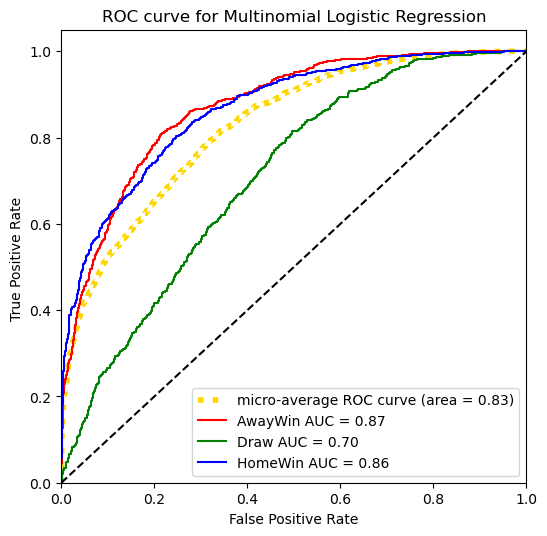

In [143]:
helperFunctions.plotROCcurve(yTrue_scores = vld_yTrue_scores, yPred_scores = vld_yPred_scores, classesInOrder = clf.classes_, classNumToName={-1:"AwayWin", 0:"Draw", 1:"HomeWin"},
title="ROC curve for Multinomial Logistic Regression")

Average precision score, micro-averaged over all classes: 0.73


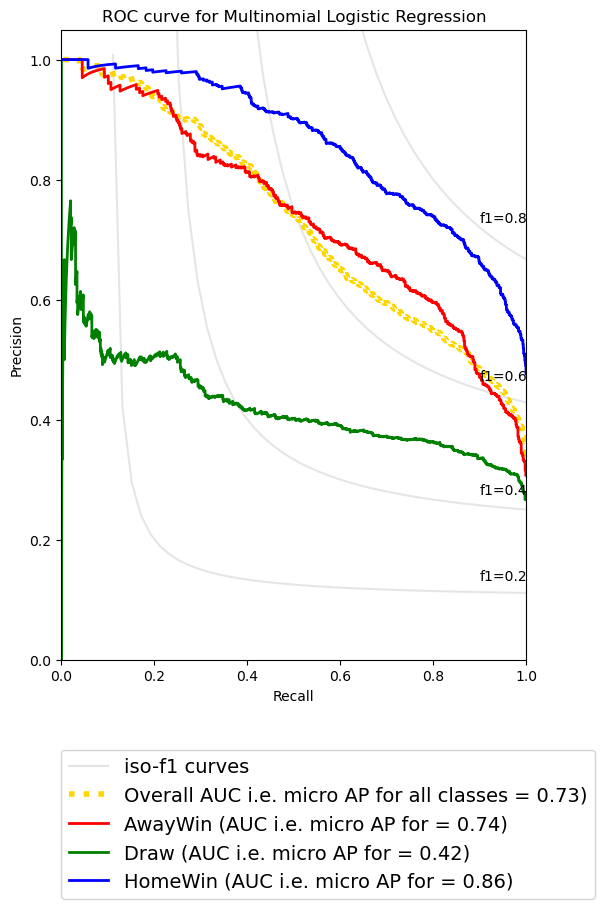

In [153]:
helperFunctions.plotPRcurve(yTrue_scores = vld_yTrue_scores, yPred_scores = vld_yPred_scores, classesInOrder = clf.classes_, classNumToName={-1:"AwayWin", 0:"Draw", 1:"HomeWin"},
title="ROC curve for Multinomial Logistic Regression")

We can now make prediction for the `og_test_df` using the classifier we trained.

In [154]:
og_test_df

,HF,HST,HY,HR,HPr5MW,HPr5MD,HPr5ML,HTHG,AF,AST,AY,AR,APr5MW,APr5MD,APr5ML,HTAG,RstDayDiff,B365HDstDrw,B365ADstDrw
0,-0.166667,0.75,-0.5,0.0,0.0,0.0,0.0,2.0,0.500000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.139410,-0.763791
1,0.666667,0.00,1.0,0.0,0.0,0.0,0.0,1.0,0.333333,-0.75,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.068948,0.028289
2,0.666667,-0.50,0.0,0.0,0.0,0.0,0.0,0.0,-0.333333,-0.50,-0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.147088,-0.101186
3,0.500000,-0.50,-0.5,0.0,0.0,0.0,0.0,0.0,0.166667,-0.50,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.712458,-0.008526
4,0.666667,0.25,0.5,0.0,0.0,0.0,0.0,0.0,0.000000,-0.50,1.5,0.0,0.0,0.0,0.0,0.0,0.0,0.147088,-0.140028
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821,-0.666667,1.50,0.0,0.0,0.4,0.4,0.2,2.0,-1.500000,-0.25,-0.5,1.0,0.4,0.0,0.6,1.0,0.0,0.510513,-0.042433
1822,-1.833333,1.00,-1.0,0.0,0.6,0.2,0.2,2.0,-0.833333,0.00,-1.0,0.0,0.4,0.4,0.2,0.0,0.0,1.562810,-0.182646
1823,0.000000,-0.50,-0.5,0.0,0.8,0.0,0.2,0.0,-1.000000,0.50,-0.5,0.0,0.8,0.2,0.0,1.0,0.5,-0.576861,2.005811
1824,-0.666667,0.25,-0.5,0.0,0.4,0.2,0.4,1.0,-0.500000,-0.25,1.0,0.0,0.4,0.0,0.6,0.0,0.0,0.904311,-0.358750


In [155]:
og_test_y = clf.predict(og_test_df)

We save the predictions in a separate directory.

In [156]:
if not os.path.exists('predictions'):
    os.mkdir('predictions')

In [159]:
unencodingDict = {-1: 'A', 0: 'D', 1: 'H'}

with open('predictions/multinomLogReg.txt', 'w') as fh:
    for prediction in og_test_y:
        fh.write(unencodingDict[int(prediction)]+"\n")